In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [39]:
### For Q-Q Plot
import scipy.stats as stats

### To ignore warnings
import warnings
warnings.filterwarnings('ignore')

### Machine Learning libraries
import sklearn
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler

from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, ExtraTreesClassifier, VotingClassifier, AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score

### To be able to see maximum columns on screen
pd.set_option('display.max_columns', 500)

In [9]:
df=pd.read_csv(r'aps-data.csv',header=2)
df.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,na,2130706438,280,0,0,0,0,0,...,1240520,493384,721044,469792,339156,157956,73224,0,0,0
1,neg,33058,na,0,na,0,0,0,0,0,...,421400,178064,293306,245416,133654,81140,97576,1500,0,0
2,neg,41040,na,228,100,0,0,0,0,0,...,277378,159812,423992,409564,320746,158022,95128,514,0,0
3,neg,12,0,70,66,0,10,0,0,0,...,240,46,58,44,10,0,0,0,4,32
4,neg,60874,na,1368,458,0,0,0,0,0,...,622012,229790,405298,347188,286954,311560,433954,1218,0,0


In [11]:
df.reset_index(inplace=True)
df.drop('index',axis=1,inplace=True)
df.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,na,2130706438,280,0,0,0,0,0,...,1240520,493384,721044,469792,339156,157956,73224,0,0,0
1,neg,33058,na,0,na,0,0,0,0,0,...,421400,178064,293306,245416,133654,81140,97576,1500,0,0
2,neg,41040,na,228,100,0,0,0,0,0,...,277378,159812,423992,409564,320746,158022,95128,514,0,0
3,neg,12,0,70,66,0,10,0,0,0,...,240,46,58,44,10,0,0,0,4,32
4,neg,60874,na,1368,458,0,0,0,0,0,...,622012,229790,405298,347188,286954,311560,433954,1218,0,0


## Statistical and Graphical Analysis

In [12]:
#replacing na values with NAN values
df=df.replace('na',np.nan)

In [14]:
#first 20 features with highest Null values
pd.DataFrame(df.isnull().sum().sort_values(ascending=False)[:20]).rename(columns={0:'Null Value Count'})

,Null Value Count
br_000,49264
bq_000,48722
bp_000,47740
bo_000,46333
ab_000,46329
cr_000,46329
bn_000,44009
bm_000,39549
bl_000,27277
bk_000,23034


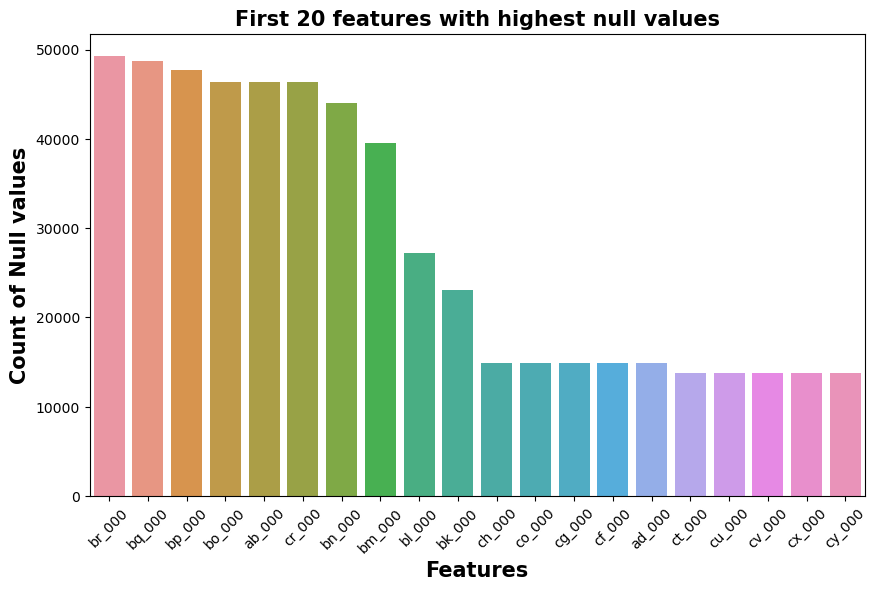

In [17]:
plt.figure(figsize=(10,6))
sns.barplot(y=df.isnull().sum().sort_values(ascending=False)[:20],x=df.isnull().sum().sort_values(ascending=False).index[:20])
plt.xlabel("Features",fontsize=15,fontweight='bold')
plt.ylabel("Count of Null values",fontsize=15,fontweight='bold')
plt.title("First 20 features with highest null values",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.show()

In [18]:
### Last 20 features with highest null values
pd.DataFrame(df.isnull().sum().sort_values(ascending=False)[-20:]).rename(columns={0:'Null Value Count'})

,Null Value Count
bg_000,642
an_000,642
al_000,642
at_000,629
as_000,629
au_000,629
ai_000,629
aj_000,629
am_0,629
bi_000,589


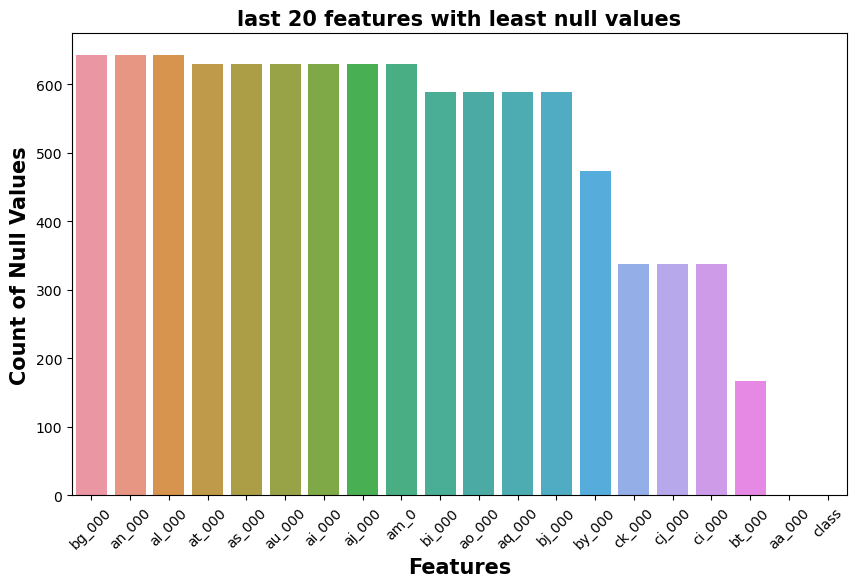

In [20]:
### Last 20 features with highest null values
plt.figure(figsize=(10,6))
sns.barplot(y=df.isnull().sum().sort_values(ascending=False)[-20:], x=df.isnull().sum().sort_values(ascending=False).index[-20:])
plt.ylabel('Count of Null Values', fontsize=15, fontweight='bold')
plt.xlabel("Features",fontsize=15, fontweight='bold')
plt.xticks(rotation=45)
plt.title("last 20 features with least null values",fontsize=15, fontweight='bold')
plt.show();

In [21]:
### Filling null values in feature with median of that feature
for feature in [feature for feature in df.columns if feature not in ['class']]:
    df[feature]=df[feature].fillna(df[feature].median())

In [23]:
### Checking Null values from top
pd.DataFrame(df.isnull().sum().sort_values(ascending=False)).rename(columns={0:'Null Value Count'})

,Null Value Count
class,0
cs_003,0
cn_009,0
co_000,0
cp_000,0
...,...
ba_005,0
ba_006,0
ba_007,0
ba_008,0


In [25]:
### checking duplicates in dataset
df.duplicated().sum()

0

In [26]:
#checking for df info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 171 entries, class to eg_000
dtypes: int64(1), object(170)
memory usage: 78.3+ MB


In [27]:
#Count of Unique values in numerical features
for fea in [fea for fea in df.columns if fea not in ['class']]:
    print('Feature {} has {} no. of Unique Values '.format(fea,df[fea].nunique()))

Feature aa_000 has 22095 no. of Unique Values 
Feature ab_000 has 30 no. of Unique Values 
Feature ac_000 has 2062 no. of Unique Values 
Feature ad_000 has 1887 no. of Unique Values 
Feature ae_000 has 334 no. of Unique Values 
Feature af_000 has 419 no. of Unique Values 
Feature ag_000 has 155 no. of Unique Values 
Feature ag_001 has 618 no. of Unique Values 
Feature ag_002 has 2423 no. of Unique Values 
Feature ag_003 has 7880 no. of Unique Values 
Feature ag_004 has 23072 no. of Unique Values 
Feature ag_005 has 40798 no. of Unique Values 
Feature ag_006 has 40616 no. of Unique Values 
Feature ag_007 has 32126 no. of Unique Values 
Feature ag_008 has 18933 no. of Unique Values 
Feature ag_009 has 5356 no. of Unique Values 
Feature ah_000 has 43572 no. of Unique Values 
Feature ai_000 has 4056 no. of Unique Values 
Feature aj_000 has 895 no. of Unique Values 
Feature ak_000 has 160 no. of Unique Values 
Feature al_000 has 9018 no. of Unique Values 
Feature am_0 has 10583 no. of Uniqu

In [28]:
#Unique values in numerical features
for fea in [fea for fea in df.columns if fea not in ['class']]:
    print('Feature {} has {} of Unique Values '.format(fea,df[fea].unique()))

Feature aa_000 has [ 76698  33058  41040 ...  83818  16978 153002] of Unique Values 
Feature ab_000 has [0.0 '0' '2' '4' '6' '8' '18' '10' '12' '16' '204' '24' '134' '90' '26'
 '14' '34' '52' '20' '22' '30' '36' '100' '48' '58' '32' '28' '44' '46'
 '68'] of Unique Values 
Feature ac_000 has ['2130706438' '0' '228' ... '8974' '123514' '2602'] of Unique Values 
Feature ad_000 has ['280' 126.0 '100' ... '5286' '3608' '194868'] of Unique Values 
Feature ae_000 has ['0' '16' '104' 0.0 '2' '222' '4' '290' '1286' '170' '6' '806' '1464'
 '274' '18' '8' '342' '64' '34' '192' '144' '176' '1512' '120' '58' '114'
 '460' '12' '112' '1314' '20' '550' '36' '1424' '180' '324' '204' '254'
 '106' '154' '92' '256' '202' '352' '26' '124' '2240' '466' '778' '28'
 '100' '14' '276' '42' '82' '22' '384' '282' '386' '98' '164' '108' '86'
 '38' '266' '1056' '134' '10' '200' '150' '326' '350' '398' '424' '32'
 '128' '752' '314' '732' '2312' '400' '158' '668' '30' '212' '224' '950'
 '4726' '60' '226' '388' '640' 

In [30]:
#Checking for dtypes of features
df.dtypes

class     object
aa_000     int64
ab_000    object
ac_000    object
ad_000    object
           ...  
ee_007    object
ee_008    object
ee_009    object
ef_000    object
eg_000    object
Length: 171, dtype: object

In [31]:
#converting Dtypes of Numerical features into int
for feature in [feature for feature in df.columns if feature not in ['class', 'aa_000']]:
    try:
        df[feature]=df[feature].astype('int64')
    except:
        df[feature]=df[feature].astype('float64')

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 171 entries, class to eg_000
dtypes: float64(5), int64(165), object(1)
memory usage: 78.3+ MB


In [34]:
## Statistical Analysis
df.describe().T

,count,mean,std,min,25%,50%,75%,max
aa_000,60000.0,5.933650e+04,1.454301e+05,0.0,834.0,30776.0,48668.0,2.746564e+06
ab_000,60000.0,1.625000e-01,1.687318e+00,0.0,0.0,0.0,0.0,2.040000e+02
ac_000,60000.0,3.362258e+08,7.767625e+08,0.0,20.0,152.0,848.0,2.130707e+09
ad_000,60000.0,1.434383e+05,3.504525e+07,0.0,42.0,126.0,292.0,8.584298e+09
ae_000,60000.0,6.535000e+00,1.581479e+02,0.0,0.0,0.0,0.0,2.105000e+04
...,...,...,...,...,...,...,...,...
ee_007,60000.0,3.428586e+05,1.718666e+06,0.0,118.0,41098.0,166346.5,1.195801e+08
ee_008,60000.0,1.372212e+05,4.472145e+05,0.0,0.0,3812.0,136725.5,1.926740e+07
ee_009,60000.0,8.295099e+03,4.721249e+04,0.0,0.0,0.0,1934.0,3.810078e+06
ef_000,60000.0,8.646667e-02,4.268570e+00,0.0,0.0,0.0,0.0,4.820000e+02


## Numerical Features

In [35]:
## getting list of Numerical features
num_fea= [fea for fea in df.columns if df[fea].dtype !='O']
print(len(num_fea))

170


In [36]:
### Getting list of Discrete Numerical features
discreate_features=[feature for feature in num_fea if df[feature].nunique()<35]
print(discreate_features)

['ab_000', 'as_000', 'cd_000', 'ch_000', 'ef_000']


In [37]:
### Getting list of Continuous Numerical features
continuous_features=[feature for feature in num_fea if feature not in discreate_features]
print(len(continuous_features))

165


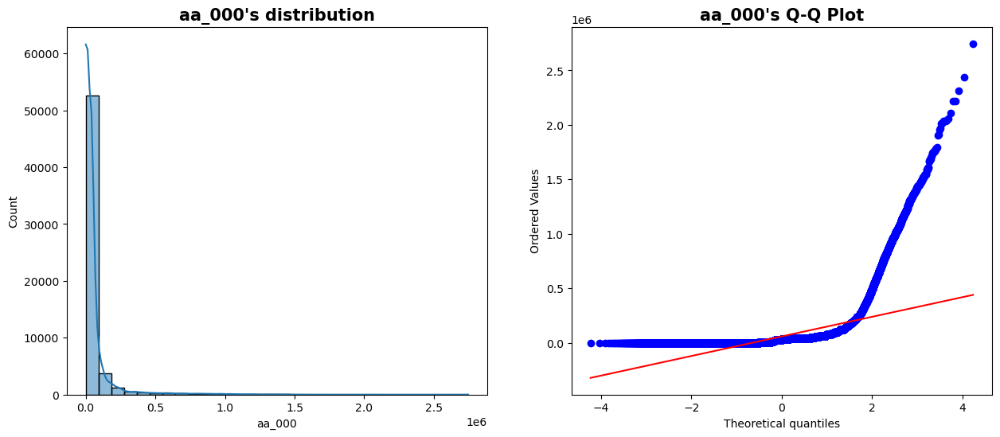

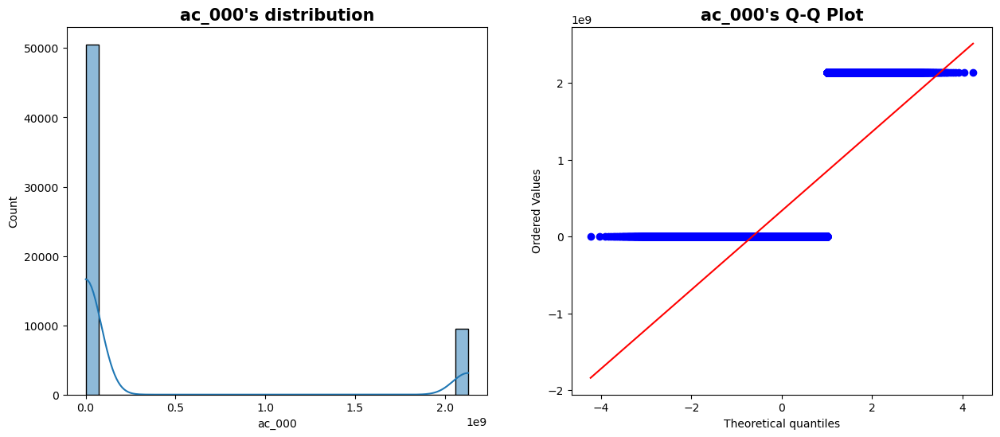

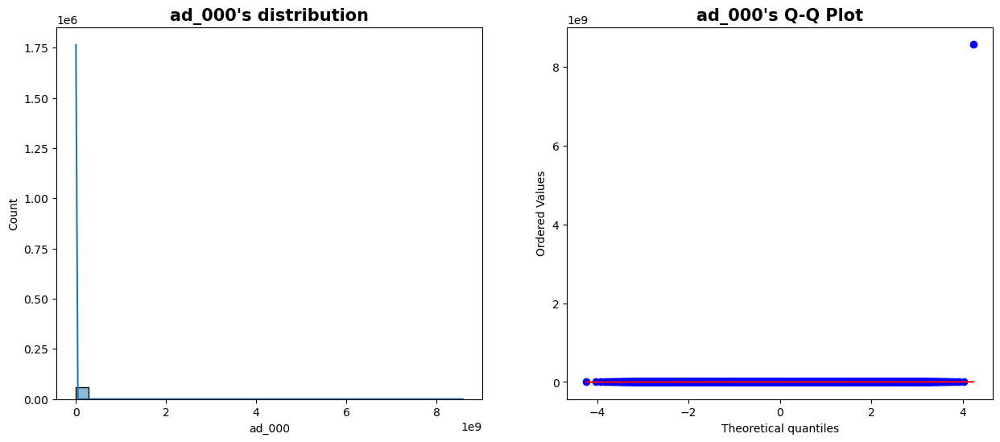

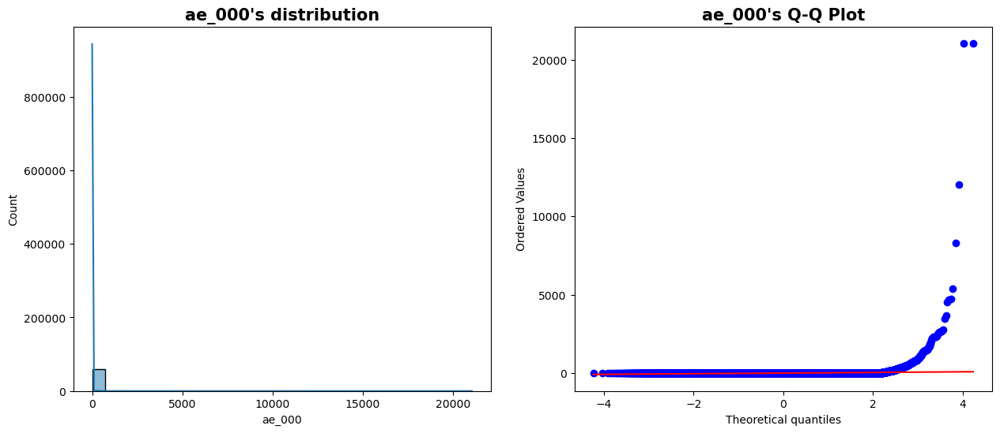

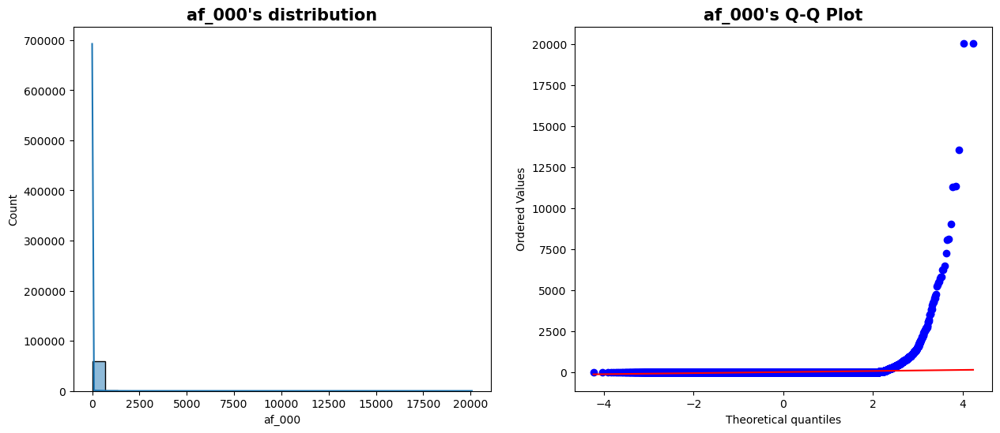

...

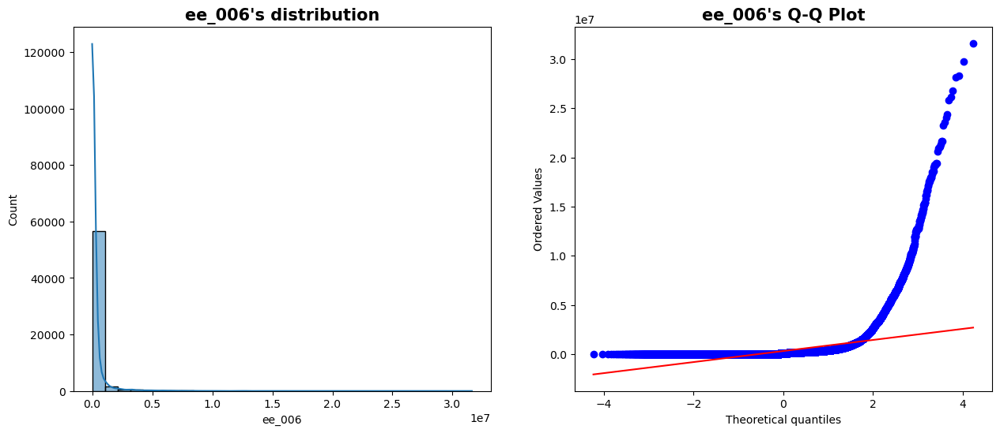

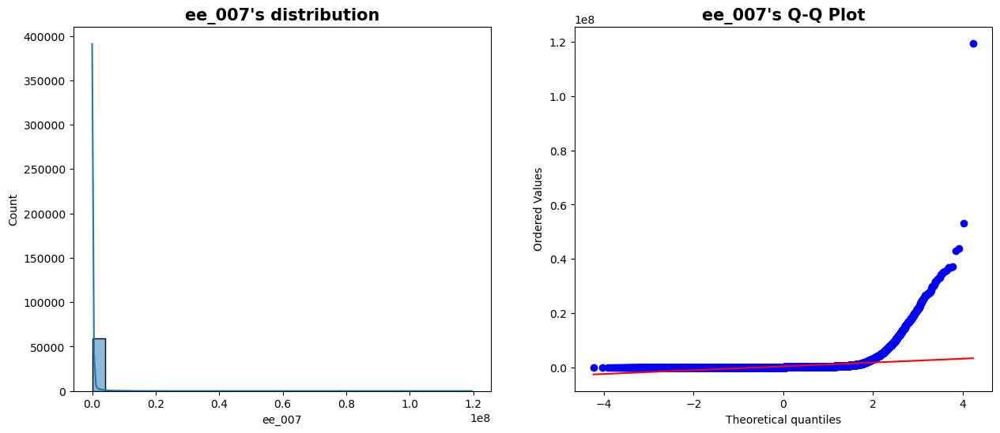

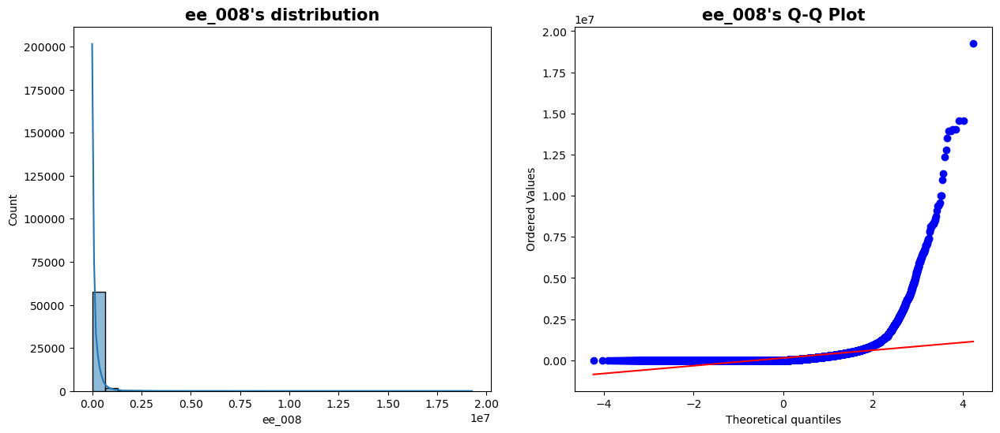

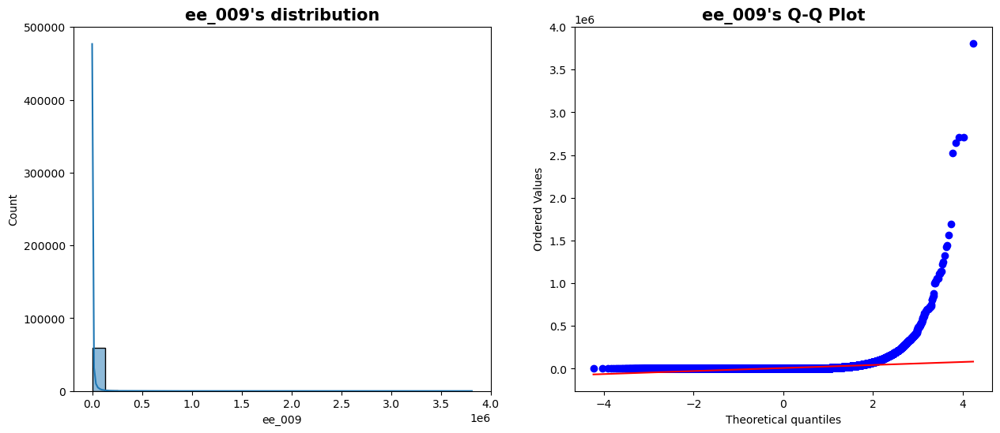

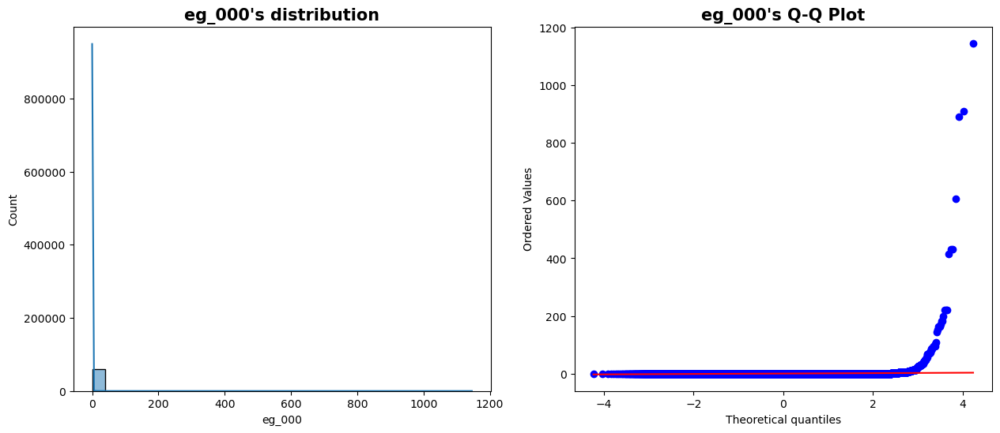

In [40]:
## Distribution of Continuous Features
for feature in continuous_features:
    plt.figure(figsize=(15,6))
    plt.subplot(121)
    sns.histplot(data=df, x=feature, kde=True, bins=30)
    plt.title("{}'s distribution".format(feature),fontweight="bold", fontsize=15)
    
    plt.subplot(122)
    stats.probplot(df[feature], dist='norm', plot=plt)
    plt.title("{}'s Q-Q Plot".format(feature),fontweight="bold", fontsize=15)
    plt.show();

In [50]:
## Checking for Outliers
plt.figure(figsize=(20,520))
for feature in enumerate(num_fea):
    plt.subplot(85, 2, feature[0]+1)
    sns.set(rc={'figure.figsize':(10,6)})
    sns.boxplot(data=df, x=feature[1], color='pink')
    plt.title("{}".format(feature[1]), fontweight="bold", fontsize=15)

In [43]:
## Handling Outliers
### Function to Cap Outlier
def remove_outliers(in_data, in_col):
    # Finding the IQR
    first_quartile = in_data[in_col].quantile(0.25)
    third_quartile = in_data[in_col].quantile(0.75)
    iqr = third_quartile - first_quartile
    upper_limit = third_quartile + 1.5 * iqr
    lower_limit = first_quartile - 1.5 * iqr
    in_data.loc[(in_data[in_col]>upper_limit), in_col]= upper_limit
    in_data.loc[(in_data[in_col]<lower_limit), in_col]= lower_limit    
    return in_data

In [44]:
### Capping outliers from continuous features
for feature in continuous_features:
    df=remove_outliers(df, feature)

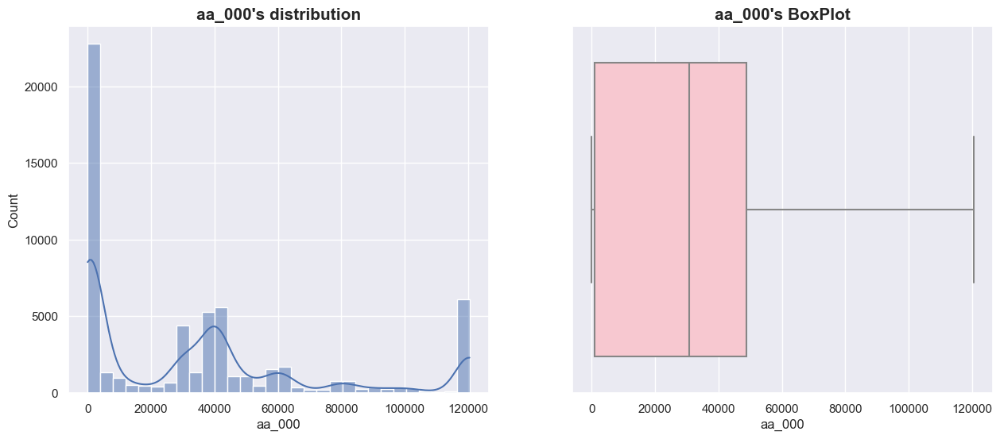

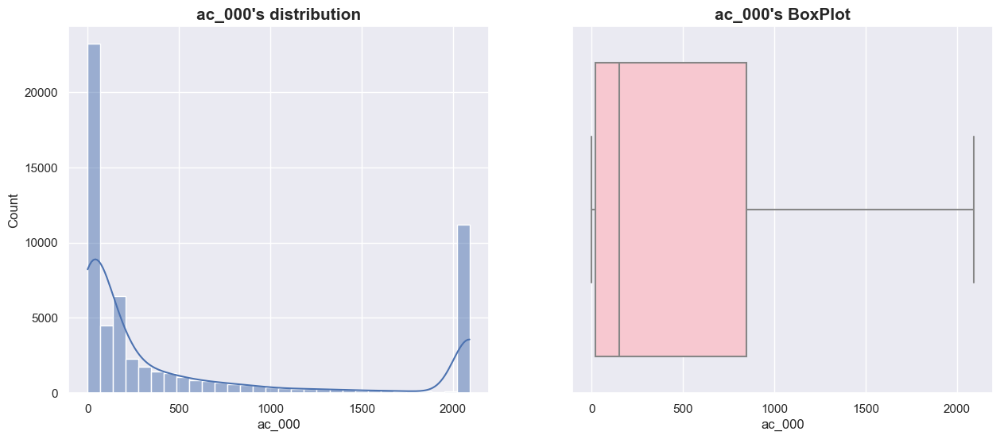

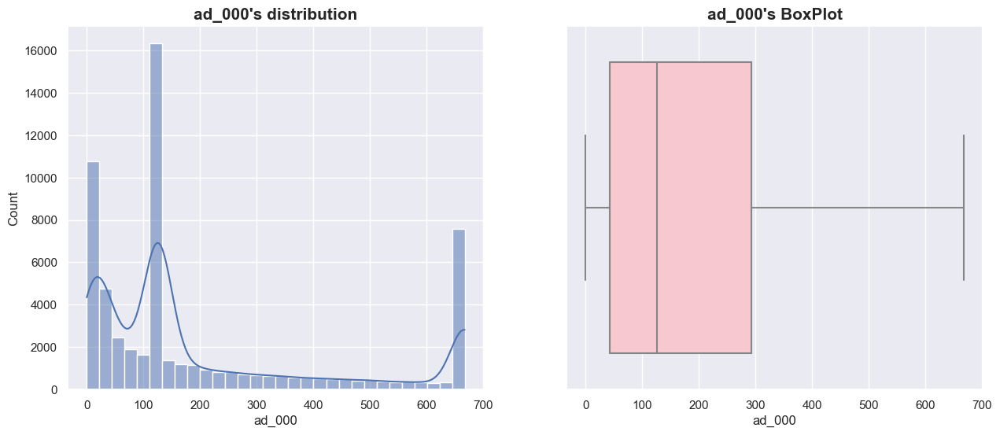

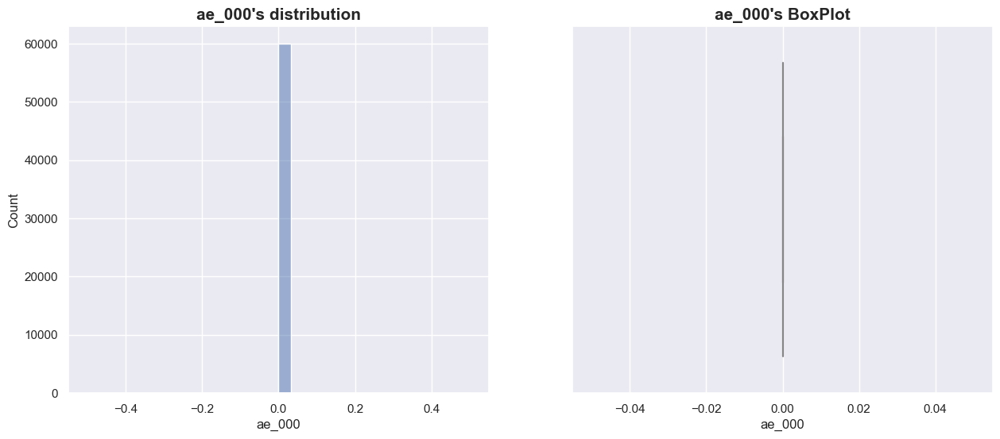

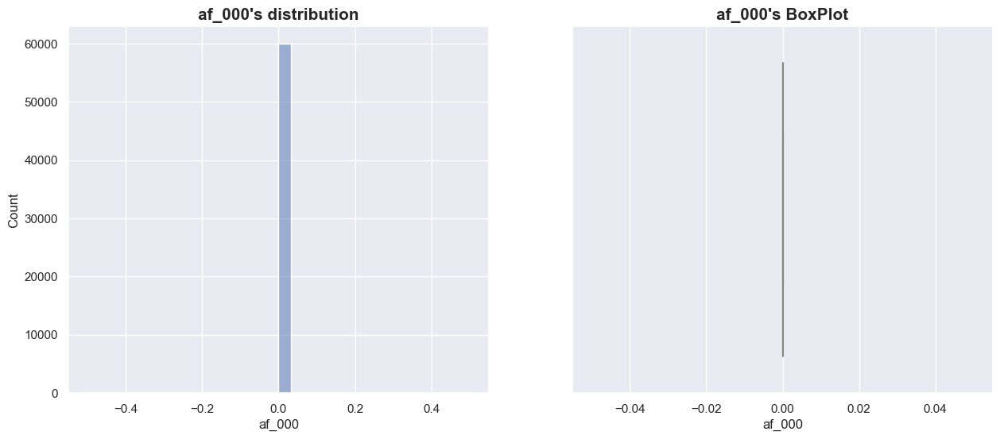

...

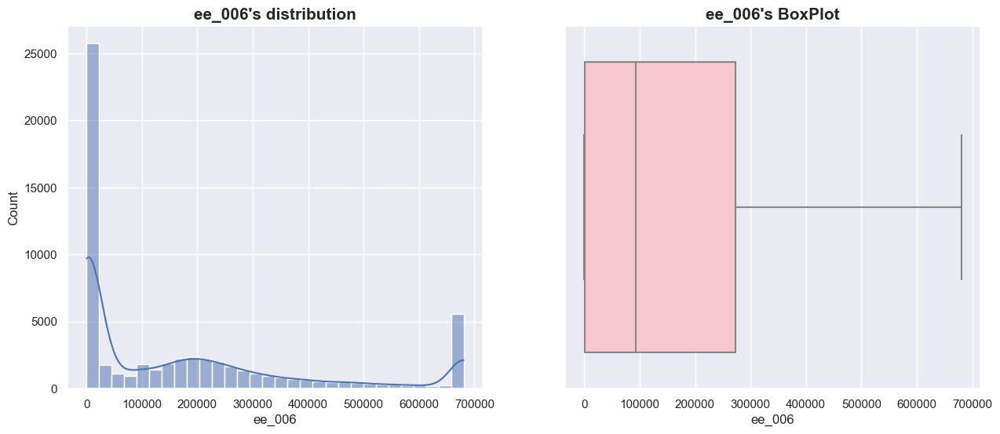

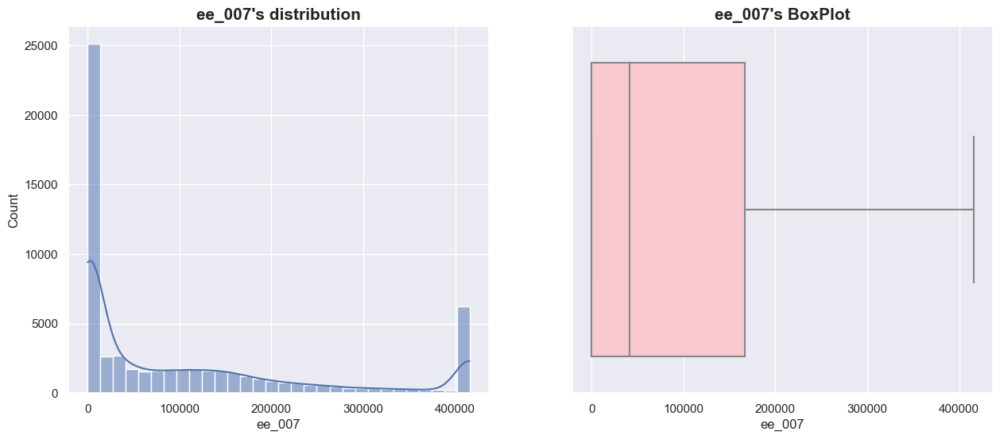

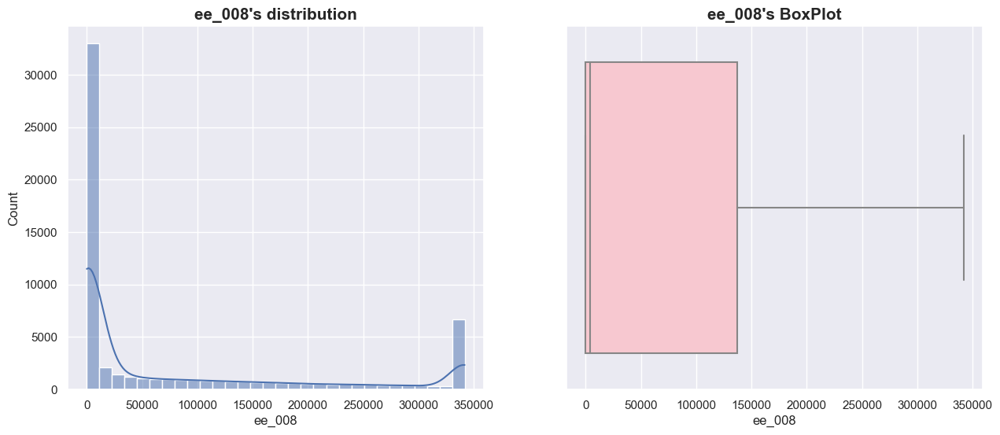

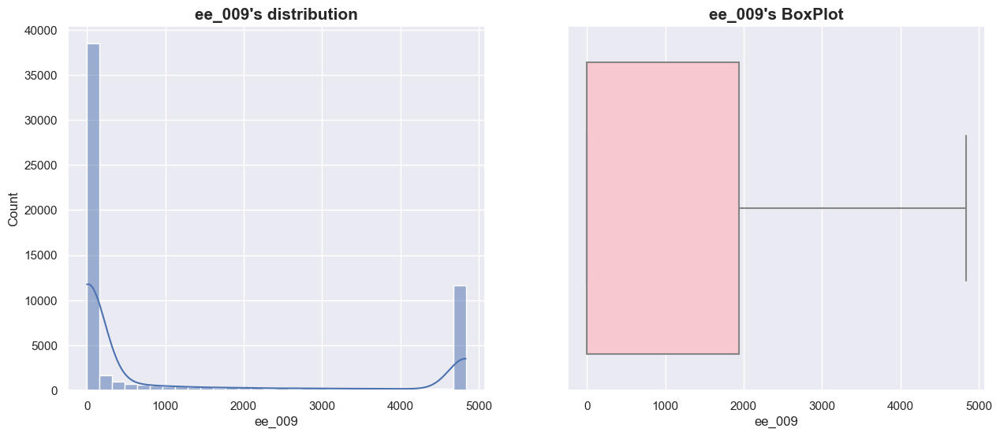

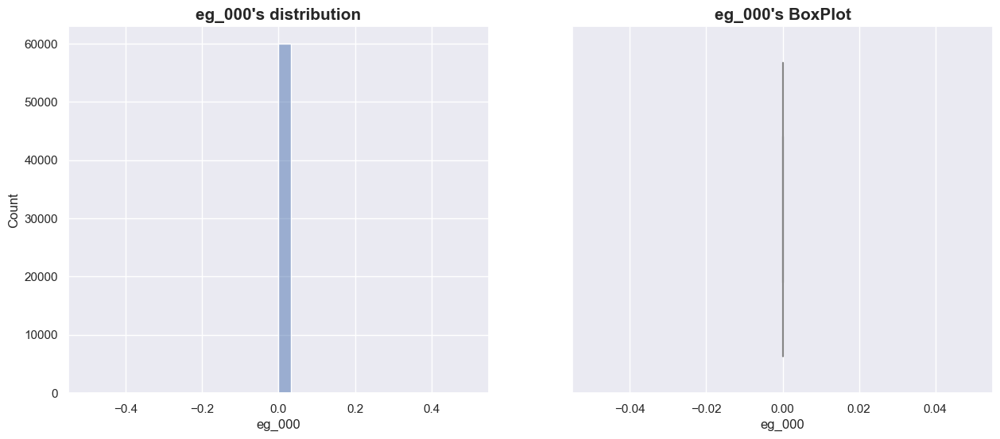

In [45]:
### Checking distribution and Boxplot of continuous features after outlier capping

for feature in continuous_features:
    plt.figure(figsize=(15,6))
    plt.subplot(121)
    sns.histplot(data=df, x=feature, kde=True, bins=30)
    plt.title("{}'s distribution".format(feature),fontweight="bold", fontsize=15)
    
    plt.subplot(122)
    sns.boxplot(data=df, x=feature, color='pink')
    plt.title("{}'s BoxPlot".format(feature),fontweight="bold", fontsize=15)
    plt.show();

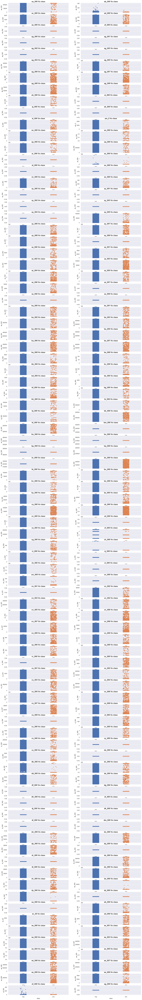

In [51]:
## Numerical features V/s Target Feature
### Checking distribution of Numerical features with respect to target feature class
plt.figure(figsize=(20,150))
for feature in enumerate(num_fea):
    plt.subplot(85, 2, feature[0]+1)
    sns.set(rc={'figure.figsize':(8,10)})
    sns.stripplot(data=df, y=feature[1], x='class')
    plt.title("{} Vs class".format(feature[1]), fontsize=15, fontweight='bold')

In [52]:
## Correlation and Heatmap
### Getting correlation between independent features
corr=round(df.corr(),2)
corr

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
aa_000,1.00,-0.02,0.20,0.41,NaN,NaN,NaN,NaN,NaN,NaN,0.51,0.79,0.84,0.67,0.54,0.37,0.96,NaN,NaN,NaN,0.23,0.23,0.96,0.96,0.89,0.89,NaN,0.03,NaN,NaN,0.40,0.41,NaN,NaN,NaN,NaN,NaN,0.43,0.61,0.79,0.63,NaN,0.70,0.65,0.66,0.49,0.67,0.78,0.12,NaN,NaN,NaN,0.86,0.91,0.92,0.92,0.91,0.86,0.80,0.64,0.47,0.17,0.95,0.43,0.43,0.52,0.43,0.96,0.92,0.88,0.86,0.02,-0.05,NaN,NaN,NaN,NaN,NaN,NaN,0.40,1.00,0.95,0.95,0.88,0.93,0.39,0.39,0.45,0.88,NaN,0.57,0.09,0.54,0.00,0.98,NaN,0.85,NaN,0.12,NaN,NaN,0.29,0.67,0.88,0.84,0.68,0.70,0.72,0.55,0.33,0.33,0.95,NaN,0.79,0.85,0.73,0.78,0.80,0.91,0.72,0.61,0.21,NaN,0.42,0.43,0.71,0.44,NaN,0.35,NaN,0.06,0.75,0.75,0.53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.90,0.72,0.71,NaN,NaN,0.80,0.79,0.46,0.49,0.01,0.02,NaN,NaN,0.47,0.66,0.70,0.80,0.84,0.88,0.88,0.86,0.85,0.83,0.76,0.54,0.38,-0.00,NaN
ab_000,-0.02,1.00,0.00,-0.04,NaN,NaN,NaN,NaN,NaN,NaN,0.04,-0.00,-0.04,-0.05,-0.03,-0.02,-0.01,NaN,NaN,NaN,0.09,0.09,-0.01,-0.01,-0.00,-0.01,NaN,-0.00,NaN,NaN,-0.01,0.00,NaN,NaN,NaN,NaN,NaN,-0.06,-0.06,-0.02,0.01,NaN,0.02,-0.00,-0.00,-0.04,-0.06,-0.01,0.13,NaN,NaN,NaN,-0.01,-0.02,-0.02,-0.03,-0.03,-0.03,-0.04,-0.03,0.03,0.11,-0.01,0.01,-0.01,-0.00,-0.04,-0.01,-0.01,-0.00,-0.01,0.02,0.01,NaN,NaN,NaN,NaN,NaN,NaN,0.01,-0.02,-0.01,-0.01,-0.01,-0.02,-0.03,-0.02,-0.01,-0.01,NaN,-0.02,0.01,-0.02,0.00,-0.02,NaN,-0.00,NaN,0.11,NaN,NaN,0.08,0.01,-0.02,-0.03,-0.02,0.00,-0.00,-0.00,-0.02,0.01,-0.01,NaN,0.01,-0.02,0.00,-0.01,-0.01,-0.03,-0.03,-0.02,-0.02,NaN,-0.04,-0.03,-0.02,-0.01,NaN,-0.03,NaN,-0.06,-0.02,-0.00,0.03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.01,-0.04,-0.04,NaN,NaN,-0.02,-0.01,-0.03,-0.03,0.05,0.05,NaN,NaN,-0.01,-0.01,0.00,-0.00,-0.02,-0.03,-0.03,-0.03,-0.03,-0.02,-0.02,-0.05,-0.05,0.06,NaN
ac_000,0.20,0.00,1.00,0.50,NaN,NaN,NaN,NaN,NaN,NaN,0.05,0.16,0.21,0.23,0.26,0.22,0.21,NaN,NaN,NaN,-0.06,-0.07,0.22,0.21,0.22,0.26,NaN,-0.01,NaN,NaN,0.48,0.47,NaN,NaN,NaN,NaN,NaN,0.12,0.18,0.18,0.15,NaN,0.06,0.08,0.09,0.12,0.09,0.24,0.06,NaN,NaN,NaN,0.20,0.24,0.21,0.21,0.21,0.18,0.19,0.17,0.06,-0.02,0.22,0.17,0.20,0.20,0.14,0.21,0.22,0.20,0.23,-0.01,-0.05,NaN,NaN,NaN,NaN,NaN,NaN,0.15,0.20,0.22,0.22,0.26,0.22,0.03,0.20,0.17,0.26,NaN,0.46,0.21,0.28,-0.00,0.22,NaN,0.24,NaN,0.29,NaN,NaN,-0.03,0.08,0.16,0.23,0.28,0.26,0.25,0.26,0.28,0.29,0.22,NaN,0.20,0.21,0.17,0.24,0.16,0.21,0.24,0.24,0.24,NaN,0.48,0.38,0.33,0.25,NaN,0.28,NaN,0.30,0.31,0.30,0.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.25,0.26,0.38,NaN,NaN,0.24,0.28,0.39,0.35,0.15,0.14,NaN,NaN,0.17,0.23,0.28,0.23,0.23,0.22,0.20,0.18,0.16,0.16,0.15,0.16,0.14,0.02,NaN
ad_000,0.41,-0.04,0.50,1.00,NaN,NaN,NaN,NaN,NaN,NaN,0.13,0.31,0.43,0.44,0.48,0.44,0.43,NaN,NaN,NaN,-0.05,-0.06,0.43,0.41,0.42,0.47,NaN,0.00,NaN,NaN,0.78,0.70,NaN,NaN,NaN,NaN,NaN,0.31,0.40,0.39,0.27,NaN,0.28,0.27,0.27,0.46,0.40,0.31,-0.01,NaN,NaN,NaN,0.42,0.44,0.41,0.41,0.40,0.38,0.39,

<AxesSubplot:>

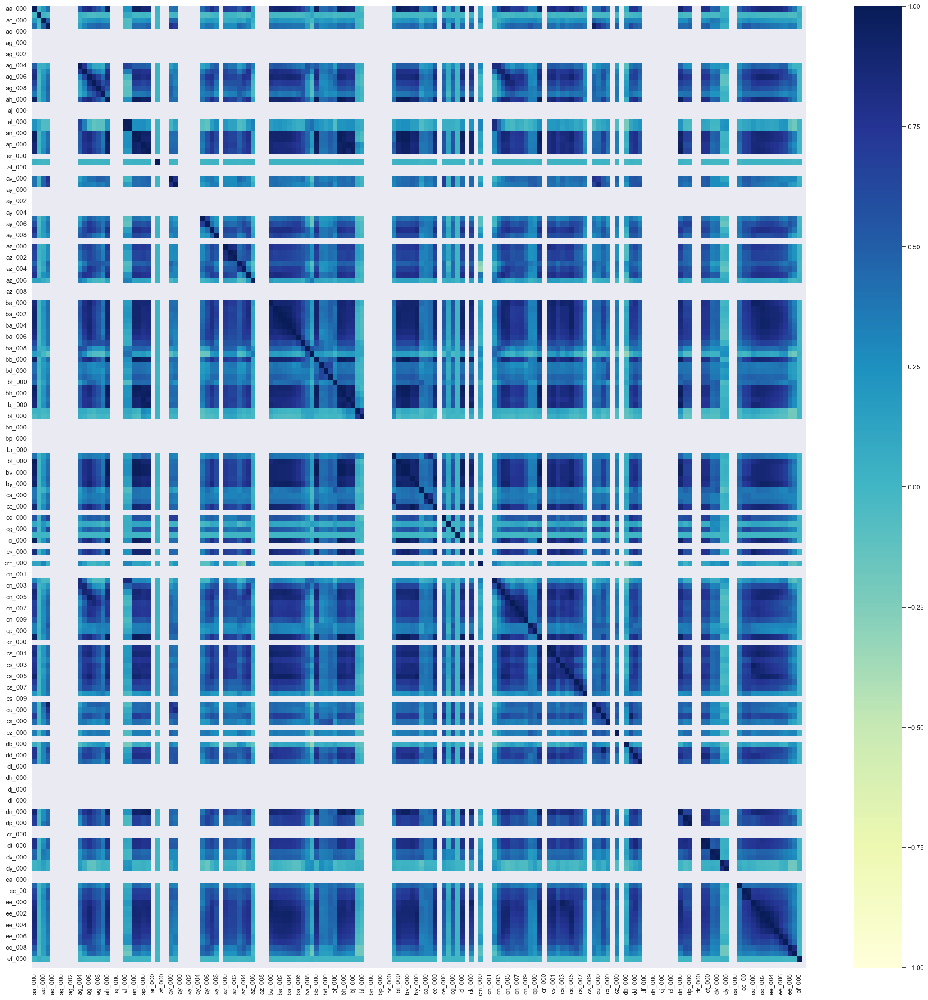

In [53]:
### Plotting heatmap for visualising the correlation between features
sns.set(rc={'figure.figsize':(30,30)})
sns.heatmap(data=corr, annot=False,  vmin=-1, vmax=1, cmap="YlGnBu")

## Scaling Data Set for PCA

In [55]:
### Creating copy of dataset
data=df.copy()
data.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,0,2090,280,0,0,0,0,0,0,37250,1432864.0,3664156.0,1007684.0,25896,0,2551696.0,0,0,0,0,0,4933296.0,3655166,1757100.75,927540.25,0,0,0,0,1012,268,0,0,0,0,0,98096.25,3140521.25,703300,755876.0,0,5374.0,2108,4114,12348.0,615248,4357659.25,2378,0,0,0,2328746.0,1022304.0,415432.0,287230,310246,457088.5,507011.25,3574.0,0,0,6700214.0,0,10,108,45,2551696.0,97518.0,914973.75,799478,293042.5,260830,239140,251400,270660,288320,305100,320400,178540.0,76698.08,6700214,6700214,6599892.0,43566.0,29489,54064.0,638360,6167850,1209600,211565,2,96,0,5245752.00,0.0,916567.68,0,135,0,0,0,118196,1309472.0,3247182,1106405,76591,11208,720,77,171,6700214,0,10476,1226,233540.5,521832.0,428776.0,4015854,895240.0,26330.0,118,0,532,734,4122704.0,51288.0,0,5991,0,18,5330690.0,4732,608,0,0,0,0,0,0,0,0,62282.0,85908,20093,0,0,202710,37928,7730555,1226459,0.00,0,0,0,2801180,2445.80,2712,965866.0,1635261.5,1083028.5,493384,721044,469792,339156,157956.0,73224.00,0,0,0
1,neg,33058,0,0,126,0,0,0,0,0,0,18254,653294.0,1720800.0,516724.0,31642,0,1393352.0,0,0,0,0,0,2560898.0,2127150,1084598.00,338544.00,0,0,0,0,0,0,0,0,0,0,0,71510.00,772720.00,1996924,99560.0,0,7336.0,4875,7587,13086.0,1010074,1873902.00,10265,0,0,0,1378576.0,447166.0,199512.0,154298,137280,138668.0,165908.00,229652.0,4250,135,3646660.0,86,454,364,45,1393352.0,49028.0,688314.00,392208,293042.5,260830,239140,251400,270660,288320,305100,320400,6700.0,33057.51,3646660,3646660,3582034.0,17733.0,29489,115626.0,6900,2942850,1209600,0,2,46,0,2291079.36,0.0,643536.96,0,0,0,0,38,98644,1179502.0,1286736,336388,36294,5192,56,8,0,3646660,0,6160,796,164860.0,350066.0,272956.0,1837600,301242.0,9148.0,22,0,210,278,1181117.0,44465.0,0,202,0,0,1734472.0,3312,522,0,0,0,0,0,0,0,0,33736.0,36946,5936,0,0,103330,16254,4510080,868538,0.00,0,0,0,3477820,2211.76,2334,664504.0,824154.0,421400.0,178064,293306,245416,133654,81140.0,97576.00,1500,0,0
2,neg,41040,0,228,100,0,0,0,0,0,0,1648,370592.0,1883374.0,292936.0,12016,0,1234132.0,0,0,0,0,0,2371990.0,2173634,300796.00,153698.00,0,0,0,0,358,110,0,0,0,0,0,0.00,870456.00,239798,1450312.0,0,1620.0,1156,1228,34250.0,1811606,710672.00,34,0,0,0,790690.0,672026.0,332340.0,254892,189596,135758.0,103552.00,81666.0,46,0,2673338.0,128,202,576,4,1234132.0,28804.0,160176.00,139730,137160.0,185390,239140,251400,270660,288320,305100,320400,28000.0,41040.08,2673338,2673338,2678534.0,15439.0,7466,22436.0,248240,2560566,1209600,63328,0,124,0,2322692.16,0.0,236099.52,0,0,0,0,0,33276,1215280.0,1102798,196502,10260,2422,28,0,6,2673338,0,3584,500,56362.0,149726.0,100326.0,1744838,488302.0,16682.0,246,0,230,292,2180528.0,29188.0,0,5991,0,0,2341048.0,1494,152,0,0,0,0,0,0,0,0,13876.0,38182,8138,0,0,65772,10534,300240,48028,0.00,0,0,0,1040120,1018.64,1020,262032.0,453378.0,277378.0,159812,423992,409564,320746,158022.0,9

In [56]:
### Creating standard scaler object for scaling data, that will be passed to PCA object for dimensionality reduction
scaler=StandardScaler()
scaler

StandardScaler()

In [57]:
### Getting independent features in a dataframe
X=data.drop('class', axis=1)
X.head()

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,ay_008,ay_009,az_000,az_001,az_002,az_003,az_004,az_005,az_006,az_007,az_008,az_009,ba_000,ba_001,ba_002,ba_003,ba_004,ba_005,ba_006,ba_007,ba_008,ba_009,bb_000,bc_000,bd_000,be_000,bf_000,bg_000,bh_000,bi_000,bj_000,bk_000,bl_000,bm_000,bn_000,bo_000,bp_000,bq_000,br_000,bs_000,bt_000,bu_000,bv_000,bx_000,by_000,bz_000,ca_000,cb_000,cc_000,cd_000,ce_000,cf_000,cg_000,ch_000,ci_000,cj_000,ck_000,cl_000,cm_000,cn_000,cn_001,cn_002,cn_003,cn_004,cn_005,cn_006,cn_007,cn_008,cn_009,co_000,cp_000,cq_000,cr_000,cs_000,cs_001,cs_002,cs_003,cs_004,cs_005,cs_006,cs_007,cs_008,cs_009,ct_000,cu_000,cv_000,cx_000,cy_000,cz_000,da_000,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,76698,0,2090,280,0,0,0,0,0,0,37250,1432864.0,3664156.0,1007684.0,25896,0,2551696.0,0,0,0,0,0,4933296.0,3655166,1757100.75,927540.25,0,0,0,0,1012,268,0,0,0,0,0,98096.25,3140521.25,703300,755876.0,0,5374.0,2108,4114,12348.0,615248,4357659.25,2378,0,0,0,2328746.0,1022304.0,415432.0,287230,310246,457088.5,507011.25,3574.0,0,0,6700214.0,0,10,108,45,2551696.0,97518.0,914973.75,799478,293042.5,260830,239140,251400,270660,288320,305100,320400,178540.0,76698.08,6700214,6700214,6599892.0,43566.0,29489,54064.0,638360,6167850,1209600,211565,2,96,0,5245752.00,0.0,916567.68,0,135,0,0,0,118196,1309472.0,3247182,1106405,76591,11208,720,77,171,6700214,0,10476,1226,233540.5,521832.0,428776.0,4015854,895240.0,26330.0,118,0,532,734,4122704.0,51288.0,0,5991,0,18,5330690.0,4732,608,0,0,0,0,0,0,0,0,62282.0,85908,20093,0,0,202710,37928,7730555,1226459,0.00,0,0,0,2801180,2445.80,2712,965866.0,1635261.5,1083028.5,493384,721044,469792,339156,157956.0,73224.00,0,0,0
1,33058,0,0,126,0,0,0,0,0,0,18254,653294.0,1720800.0,516724.0,31642,0,1393352.0,0,0,0,0,0,2560898.0,2127150,1084598.00,338544.00,0,0,0,0,0,0,0,0,0,0,0,71510.00,772720.00,1996924,99560.0,0,7336.0,4875,7587,13086.0,1010074,1873902.00,10265,0,0,0,1378576.0,447166.0,199512.0,154298,137280,138668.0,165908.00,229652.0,4250,135,3646660.0,86,454,364,45,1393352.0,49028.0,688314.00,392208,293042.5,260830,239140,251400,270660,288320,305100,320400,6700.0,33057.51,3646660,3646660,3582034.0,17733.0,29489,115626.0,6900,2942850,1209600,0,2,46,0,2291079.36,0.0,643536.96,0,0,0,0,38,98644,1179502.0,1286736,336388,36294,5192,56,8,0,3646660,0,6160,796,164860.0,350066.0,272956.0,1837600,301242.0,9148.0,22,0,210,278,1181117.0,44465.0,0,202,0,0,1734472.0,3312,522,0,0,0,0,0,0,0,0,33736.0,36946,5936,0,0,103330,16254,4510080,868538,0.00,0,0,0,3477820,2211.76,2334,664504.0,824154.0,421400.0,178064,293306,245416,133654,81140.0,97576.00,1500,0,0
2,41040,0,228,100,0,0,0,0,0,0,1648,370592.0,1883374.0,292936.0,12016,0,1234132.0,0,0,0,0,0,2371990.0,2173634,300796.00,153698.00,0,0,0,0,358,110,0,0,0,0,0,0.00,870456.00,239798,1450312.0,0,1620.0,1156,1228,34250.0,1811606,710672.00,34,0,0,0,790690.0,672026.0,332340.0,254892,189596,135758.0,103552.00,81666.0,46,0,2673338.0,128,202,576,4,1234132.0,28804.0,160176.00,139730,137160.0,185390,239140,251400,270660,288320,305100,320400,28000.0,41040.08,2673338,2673338,2678534.0,15439.0,7466,22436.0,248240,2560566,1209600,63328,0,124,0,2322692.16,0.0,236099.52,0,0,0,0,0,33276,1215280.0,1102798,196502,10260,2422,28,0,6,2673338,0,3584,500,56362.0,149726.0,100326.0,1744838,488302.0,16682.0,246,0,230,292,2180528.0,29188.0,0,5991,0,0,2341048.0,1494,152,0,0,0,0,0,0,0,0,13876.0,38182,8138,0,0,65772,10534,300240,48028,0.00,0,0,0,1040120,1018.64,1020,262032.0,453378.0,277378.0,159812,423992,409564,320746,158022.0,95128.00,514,0,0
3,

In [58]:
### seperating target feature
y=data['class']
y.unique()

array(['neg', 'pos'], dtype=object)

In [59]:
### encoding target feature
y=y.replace({'neg':0, 'pos':1})

In [60]:
y.unique()

array([0, 1], dtype=int64)

In [62]:
### Scaling data for PCA
X_scaled=scaler.fit_transform(X)   
X_scaled 

array([[ 1.085094  , -0.0963075 ,  1.90171152, ..., -0.61980094,
        -0.02025676,  0.        ],
       [-0.05556902, -0.0963075 , -0.7342963 , ...,  0.15191295,
        -0.02025676,  0.        ],
       [ 0.15306462, -0.0963075 , -0.44673181, ..., -0.35536031,
        -0.02025676,  0.        ],
       ...,
       [-0.91671209, -0.0963075 ,  1.90171152, ..., -0.61980094,
        -0.02025676,  0.        ],
       [ 1.17903402, -0.0963075 ,  1.90171152, ...,  1.86769017,
        -0.02025676,  0.        ],
       [ 0.13168373, -0.0963075 ,  0.14605464, ..., -0.53851374,
        -0.02025676,  0.        ]])

## Function for Model Training, Evaluation and feature reduction using PCA


In [63]:
### Creating function that will evaluate model
def model_evaluator(actual_val, pred_val):
    """
    The function takes actual value and predicted value as argument 
    and returns Accuracy, Precision, Recall, F-1 Score rounded to 
    3 decimal places.
    """
    acc=round(accuracy_score(actual_val, pred_val),5)
    prec=round(precision_score(actual_val, pred_val),5)
    rec=round(recall_score(actual_val, pred_val),5) 
    roc_auc=round(roc_auc_score(actual_val, pred_val),5)
    return acc, prec, rec, roc_auc

In [64]:
### creating dictionary containing model objects for different algorithmn
models={
    "Logistic Regression":LogisticRegression(),
    "Support Vector Classifier":SVC(),
    "Decision Tree Classifier":DecisionTreeClassifier(),
    "Random Forest Classifier":RandomForestClassifier(),
    "Bagging Classifier": BaggingClassifier(base_estimator=LogisticRegression()),
    "Extra Tree Classifier": ExtraTreesClassifier(),
    "AdaBoost Classifier": AdaBoostClassifier(),
    "GradientBoost Classifier": GradientBoostingClassifier(),
    "XGBoost Classifier": XGBClassifier()
}

In [65]:
### Creating function for model training
def model_trainer(model, X_train_data, y_train_data, X_test_data):
    """
    This function takes model object, X train data, y train data, and 
    X test data as argument, trains model and gives prediction for train data 
    and prediction for test data.
    """
    model.fit(X_train_data, y_train_data)
    y_train_pred=model.predict(X_train_data)
    pred_val=model.predict(X_test_data)
    return y_train_pred, pred_val

In [66]:
def pca_dataframe(scaled_data, features_req):
    """
    This function takes scaled dataframe and No. of features to be reduced as an 
    argument and returns the datafeame with reduced features equal to No. of features
    argument.
    """
    pca=PCA(n_components=features_req,copy=True )
    pca.fit(scaled_data)
    X=pca.transform(scaled_data)
    X=pd.DataFrame(X)
    return X

## Fifty Feature Dataset, Model training and evaluation

In [68]:
### Reducing 170 features to 50 Principal Components(features) using PCA 
X_50=pca_dataframe(X_scaled, 50)
X_50.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
0,13.197779,-2.462133,-0.618696,1.404158,-2.841379,2.739933,2.715727,3.585961,-1.080350,-0.498468,-0.672236,0.289610,2.386514,0.778140,2.004284,-1.514287,0.535893,-0.469318,-1.308284,-1.567522,0.066636,-0.932432,1.437345,-0.121161,0.611805,-0.032774,-0.261530,1.189670,0.205671,0.728285,1.382990,0.630395,0.849121,-0.060209,-0.017199,0.014904,-0.876555,-0.196209,0.131026,-0.023277,-0.521884,-0.891385,-0.778213,0.545013,-0.206661,0.588125,0.647490,-0.917862,0.093864,-0.415041
1,3.480184,1.680163,-1.770129,1.522659,-3.893827,-1.540386,-0.300754,0.851734,0.099207,-2.107981,-1.334149,-2.270153,1.181768,0.466827,0.350165,0.091902,0.308115,0.153636,-0.687506,0.852720,0.276669,-0.569572,-1.396496,-0.039484,-1.085998,1.072981,0.308329,0.581956,-0.136912,0.673743,-1.384342,-0.709326,0.203500,0.214512,-0.680436,-0.050256,-1.136994,0.938471,0.367047,-0.079164,1.185942,-1.292666,-0.073207,-0.208293,1.181073,-0.529432,-0.327725,-0.802029,1.903020,-1.534346
2,-0.124498,-1.164830,-1.345961,-1.874898,1.909023,0.401288,0.835691,-1.523711,-0.160507,-0.729582,-1.707177,1.346427,-0.750416,-0.223950,0.156937,1.023115,0.127485,0.082696,-0.421450,0.119312,-0.211862,0.228047,-0.329737,0.207165,-0.921769,-0.516074,0.727746,-0.979558,0.736715,1.344375,0.935629,0.820474,-0.506882,-0.425214,-0.648626,0.246985,0.126457,-0.995155,-0.399881,0.288863,-0.531405,-0.566405,0.679262,0.421881,-0.190269,0.291522,-0.406877,0.414563,-0.471372,0.077129
3,-8.397505,1.185062,-0.187634,0.111246,-0.016147,0.982909,-0.291405,-0.625203,-0.373484,-0.188330,1.443730,0.130908,-0.651746,0.792604,0.499299,0.015549,-0.097623,0.140942,0.208602,-0.626835,0.701739,-0.195666,-0.276470,0.190005,0.333742,0.245032,0.033529,-0.130326,0.442908,-0.268384,-0.005974,0.292236,-0.113545,-0.390161,-0.190455,-0.115353,0.516464,-0.284599,0.043525,0.061664,-0.073846,-0.120070,0.102902,-0.025271,0.249186,-0.149550,-0.076362,0.247540,-0.084407,-0.180812
4,6.759583,-1.761896,5.197655,-0.874636,0.449099,-1.888367,2.094476,-1.057564,-2.152047,0.422134,0.635572,0.622428,3.264293,3.844619,-0.827280,-0.079294,-0.045714,0.161565,0.013634,0.654553,-0.856315,-0.734285,-0.586635,-0.497032,2.042751,-0.734397,-1.258293,-0.342757,-0.666866,-0.030724,0.740792,0.586061,0.691380,-0.491222,-0.315343,-0.157565,0.409515,-0.666470,0.971163,-0.224642,-0.375192,-0.432416,-1.154406,-0.074857,-0.392485,-0.700717,0.359277,-0.615921,-0.166759,-0.052971


In [69]:
### train test split
X_train, X_test, y_train, y_test = train_test_split(X_50, y, test_size=0.25, random_state=19)

In [70]:
### Creating empty list to store model names
model_list=[]
### creating empty list to store accuracy score for each model
acc_score_list=[]
### creating empty list for storing precision score
prec_score_list=[]
### creating list to store recall score
recall_list=[]
### creating list to store roc_auc score
roc_auc_list=[]

### Training all models and getting their performance and storing it in empty list
for num in range(len(list(models))):
    ### selecting model
    model=list(models.values())[num]
    
    ### getting training data prediction and test data prediction
    y_pred, pred_val=model_trainer(model,X_train, y_train, X_test)
    
    ### Getting model performance parameters for training data
    acc_score, prec_score, rec_score, roc_auc=model_evaluator(y_train,y_pred )
    print("{} Model\n".format(list(models.keys())[num]))
    print("Model Performance for training dataset")
    print("Accuracy score: {}\nPrecision Score: {}\nRecall Score: {}\nRoc_Auc Score: {}".format(acc_score,prec_score, rec_score, roc_auc))
    print("-"*50)
    
    ### Getting model performance parameters for test data
    acc_score, prec_score, rec_score, roc_auc=model_evaluator(y_test,pred_val)
    print("Model Performance for Test dataset")
    print("Accuracy score: {}\nPrecision Score: {}\nRecall Score: {}\nRoc_Auc Score: {}".format(acc_score,prec_score, rec_score, roc_auc))
    
    ### Appending model name and Performance score in seperate list so that models can be sorted in terms of performance
    model_list.append(list(models.keys())[num])
    acc_score_list.append(acc_score)
    prec_score_list.append(prec_score)
    recall_list.append(rec_score)
    roc_auc_list.append(roc_auc)
    print("*"*50)
    print("\n")

Logistic Regression Model

Model Performance for training dataset
Accuracy score: 0.9876
Precision Score: 0.75342
Recall Score: 0.37012
Roc_Auc Score: 0.68404
--------------------------------------------------
Model Performance for Test dataset
Accuracy score: 0.98653
Precision Score: 0.72358
Recall Score: 0.3463
Roc_Auc Score: 0.672
**************************************************


Support Vector Classifier Model

Model Performance for training dataset
Accuracy score: 0.99093
Precision Score: 0.93506
Recall Score: 0.48452
Roc_Auc Score: 0.74198
--------------------------------------------------
Model Performance for Test dataset
Accuracy score: 0.9892
Precision Score: 0.85185
Recall Score: 0.44747
Roc_Auc Score: 0.72306
**************************************************


Decision Tree Classifier Model

Model Performance for training dataset
Accuracy score: 1.0
Precision Score: 1.0
Recall Score: 1.0
Roc_Auc Score: 1.0
--------------------------------------------------
Model Perform

In [71]:
### Tabulating model performance in dataframe
model_perf_50=pd.DataFrame(list(zip(model_list, acc_score_list,prec_score_list, recall_list, roc_auc_list)), columns=['Model', 'Accuracy', 'Precision', 'Recall', 'Roc_Auc Score']).sort_values(by=['Accuracy'], ascending=False,).reset_index()
model_perf_50.drop('index', axis=1, inplace=True)
model_perf_50

,Model,Accuracy,Precision,Recall,Roc_Auc Score
0,XGBoost Classifier,0.98960,0.81761,0.50584,0.75193
1,Support Vector Classifier,0.98920,0.85185,0.44747,0.72306
2,Random Forest Classifier,0.98660,0.87838,0.25292,0.62615
3,Logistic Regression,0.98653,0.72358,0.34630,0.67200
4,Extra Tree Classifier,0.98653,0.88732,0.24514,0.62230
5,GradientBoost Classifier,0.98653,0.75701,0.31518,0.65671
6,Bagging Classifier,0.98613,0.69291,0.34241,0.66988
7,Decision Tree Classifier,0.98360,0.52191,0.50973,0.75079
8,AdaBoost Classifier,0.98333,0.52147,0.33074,0.66272


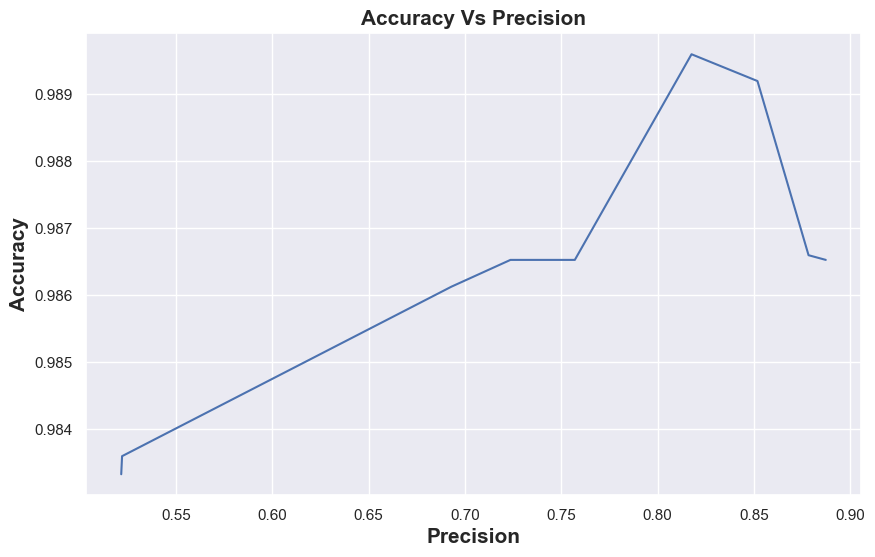

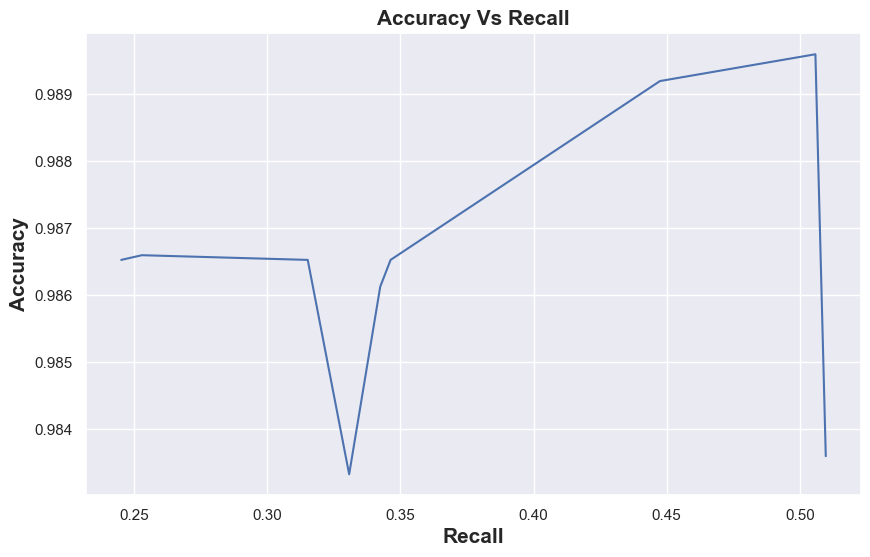

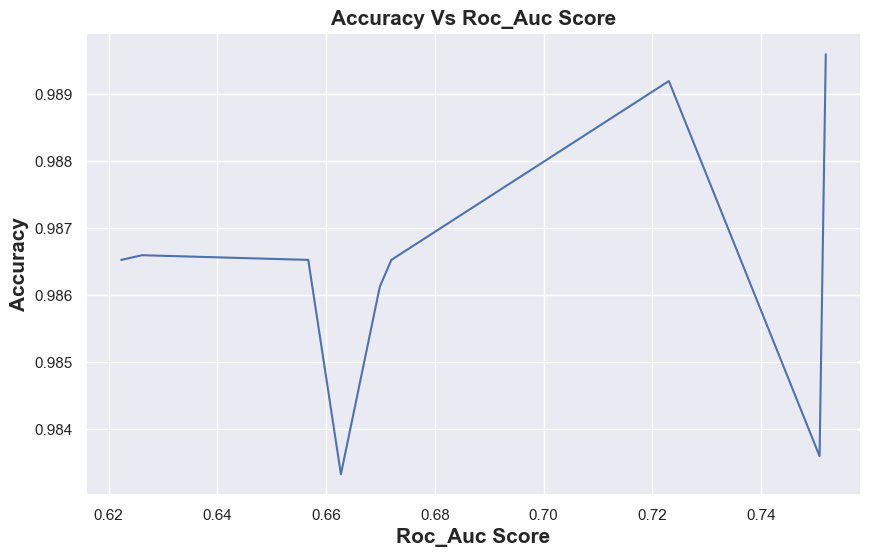

In [72]:
### Accuracy vs Precision and Recall
for feature1 in ['Accuracy']:
    for feature2 in ['Precision', 'Recall', 'Roc_Auc Score']:
        plt.figure(figsize=(10,6))
        sns.lineplot(y=feature1, x=feature2, data=model_perf_50)
        plt.xlabel("{}".format(feature2), fontweight='bold', fontsize=15)
        plt.ylabel("{}".format(feature1), fontweight='bold', fontsize=15)
        plt.title("{} Vs {}".format(feature1, feature2), fontweight='bold', fontsize=15)

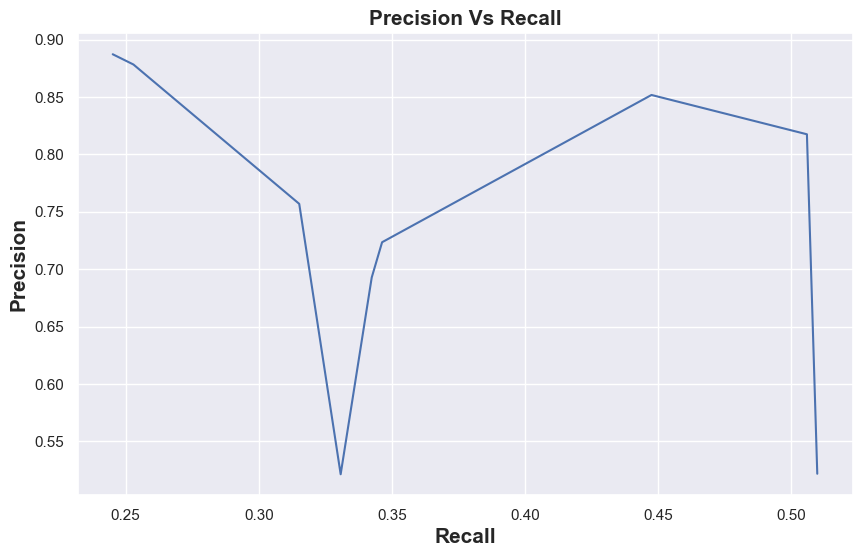

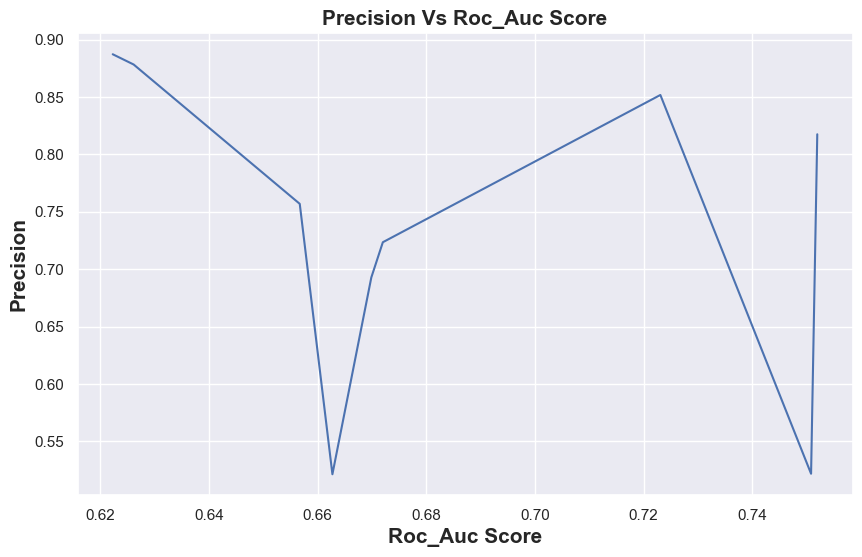

In [73]:
## Precision vs Recall and Roc_Auc Score
for feature1 in ['Precision']:
    for feature2 in [ 'Recall','Roc_Auc Score' ]:
        plt.figure(figsize=(10,6))
        sns.lineplot(y=feature1, x=feature2, data=model_perf_50)
        plt.xlabel("{}".format(feature2), fontweight='bold', fontsize=15)
        plt.ylabel("{}".format(feature1), fontweight='bold', fontsize=15)
        plt.title("{} Vs {}".format(feature1, feature2), fontweight='bold', fontsize=15)